# Imports / Dataloads

In [1]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import pickle

import re
import string
import nltk
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer, PorterStemmer
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, precision_score, recall_score
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import LabelBinarizer, LabelEncoder, MinMaxScaler
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity as cs
from sklearn.pipeline import Pipeline
from sklearn.naive_bayes import MultinomialNB
from sklearn.multiclass import OneVsRestClassifier
from sklearn.naive_bayes import ComplementNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC

from wordcloud import WordCloud

import warnings

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/alinapetukhova/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     /Users/alinapetukhova/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/alinapetukhova/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [2]:
# !pip install pandas matplotlib seaborn nltk scikit-learn wordcloud

In [3]:
import nltk
nltk.download('omw-1.4')

[nltk_data] Downloading package omw-1.4 to
[nltk_data]     /Users/alinapetukhova/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [4]:
default_stemmer = PorterStemmer()
default_stopwords = stopwords.words('english')
default_stopwords = default_stopwords + ['said', 'would','even','according','could','year',
                                         'years','also','new','people','old,''one','two','time',
                                         'first','last','say','make','best','get','three','make',
                                         'year old','told','made','like','take','many','set','number',
                                         'month','week','well','back']
shortword = re.compile(r'\W*\b\w{1,4}\b\d')
BAD_SYMBOLS_RE = re.compile("[^a-zA-Z,\d]")
REPLACE_IP_ADDRESS = re.compile(r'\b(?:[0-9]{1,3}\.){3}[0-9]{1,3}\b')
REPLACE_BY_SPACE_RE = re.compile('[/(){}\[\]\|@,;]')
def clean_text(text, ):

    def tokenize_text(text):
        return [w for s in sent_tokenize(text) for w in word_tokenize(s) if len(w)>=3]

    def preprocessing_text(text):
        text = text.lower()
        text=text.replace('\n',' ').replace('\xa0',' ').replace('-',' ').replace('ó','o').replace('ğ','g').replace('á','a').replace("'"," ")
        text=re.sub(r'\d+','', text)
        text=re.sub(r'http\S+', '', text)
        text=BAD_SYMBOLS_RE.sub(' ', text)
        text=REPLACE_IP_ADDRESS.sub('', text)
        text=REPLACE_BY_SPACE_RE.sub(' ', text)
        text=' '.join(word for word in text.split() if len(word)>3)
        
        return text

    def remove_special_characters(text, characters=string.punctuation.replace('-', '')):
        tokens = tokenize_text(text)
        pattern = re.compile('[{}]'.format(re.escape(characters + '0123456789')))
        return ' '.join(filter(None, [pattern.sub('', t) for t in tokens]))

    def stem_text(text, stemmer=default_stemmer):
        tokens = tokenize_text(text)
        return ' '.join([stemmer.stem(t) for t in tokens])

    def lemm_text(text, lemm=WordNetLemmatizer()):
        tokens = tokenize_text(text)
        return ' '.join([lemm.lemmatize(t) for t in tokens])

    def remove_stopwords(text, stop_words=default_stopwords):
        tokens = [w for w in tokenize_text(text) if w not in stop_words]
        return ' '.join(tokens)
    
    text = text.strip(' ') # strip whitespaces
    text = text.lower() # lowercase
    #text = stem_text(text) # stemming
    text=preprocessing_text(text)
    text = remove_special_characters(text) # remove punctuation and symbols
    text = lemm_text(text) # lemmatizer
    text = remove_stopwords(text) # remove stopwords

    return text

In [5]:
# pip freeze > requirements.txt

In [6]:
df = pd.read_csv('https://zenodo.org/record/7394851/files/MN-DS-news-classification.csv?download=1')

Articles number


In [7]:
df.id.count()

10917

Category number

In [8]:
df.category_level_1.nunique(), df.category_level_2.nunique()

(17, 109)

 Media sources number

In [9]:
df.source.nunique()

215

Review transfered data

In [10]:
df.columns

Index(['data_id', 'id', 'date', 'source', 'title', 'content', 'author', 'url',
       'published', 'published_utc', 'collection_utc', 'category_level_1',
       'category_level_2'],
      dtype='object')

The number of articles under each Level 1 category.

In [11]:
df.groupby(['category_level_1'])['data_id'].agg('count')

category_level_1
arts, culture, entertainment and media        300
conflict, war and peace                       800
crime, law and justice                        500
disaster, accident and emergency incident     500
economy, business and finance                 400
education                                     607
environment                                   600
health                                        700
human interest                                600
labour                                        703
lifestyle and leisure                         300
politics                                      900
religion and belief                           800
science and technology                        800
society                                      1100
sport                                         907
weather                                       400
Name: data_id, dtype: int64

In [12]:
df['combined_categories']= df[['category_level_1', 'category_level_2']].apply(lambda x: ' . '.join(x.astype(str)),axis=1)

In [13]:
df['text']= df[['title', 'content']].apply(lambda x: ' . '.join(x.astype(str)),axis=1)

Text tokeniztion and cleaning

In [14]:
df['text']=df['text'].apply(clean_text)

Word cloud of MN-DS dataset for selected second-level categories.

In [15]:
def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='white',
        stopwords=default_stopwords,
        max_words=200,
        max_font_size=40, 
        scale=3,
        random_state=1 # chosen at random by flipping a coin; it was heads
    ).generate(str(data))

    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()
    
    fig.savefig(title, bbox_inches='tight')

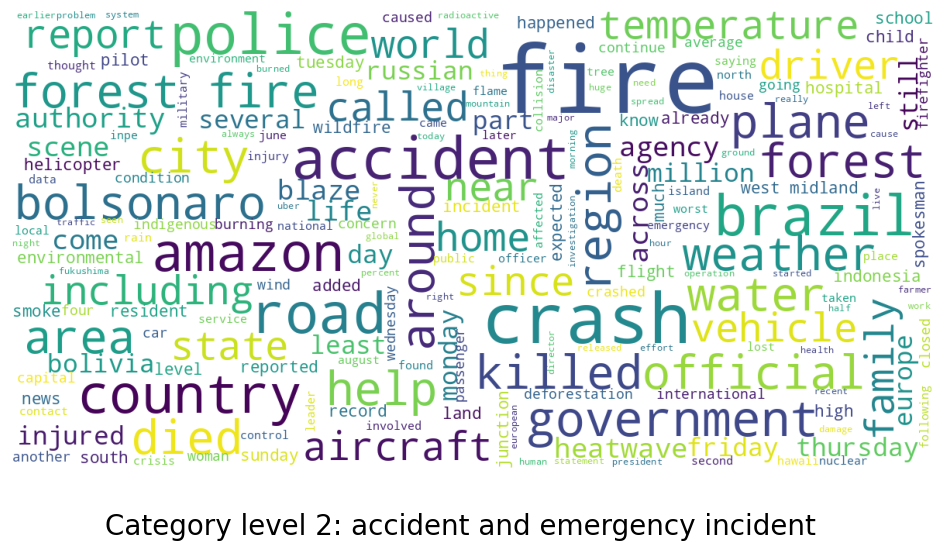

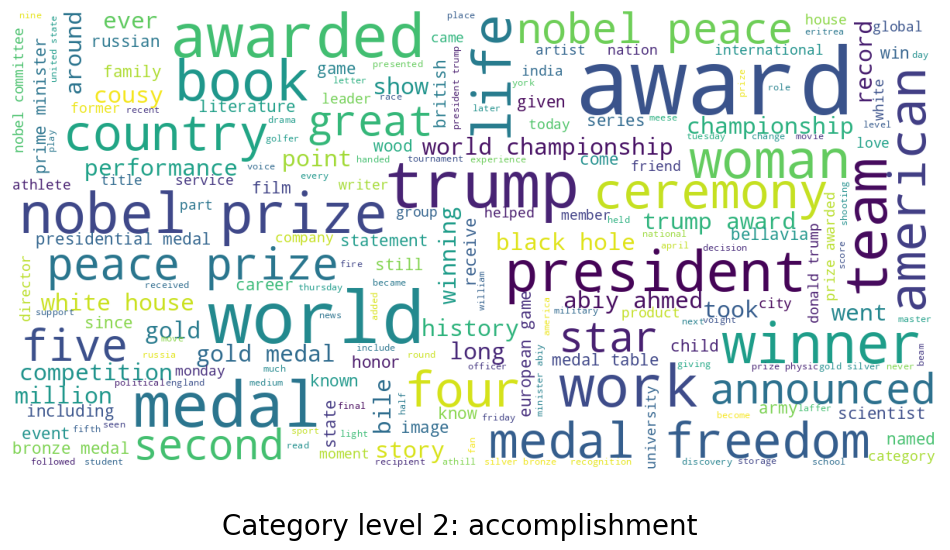

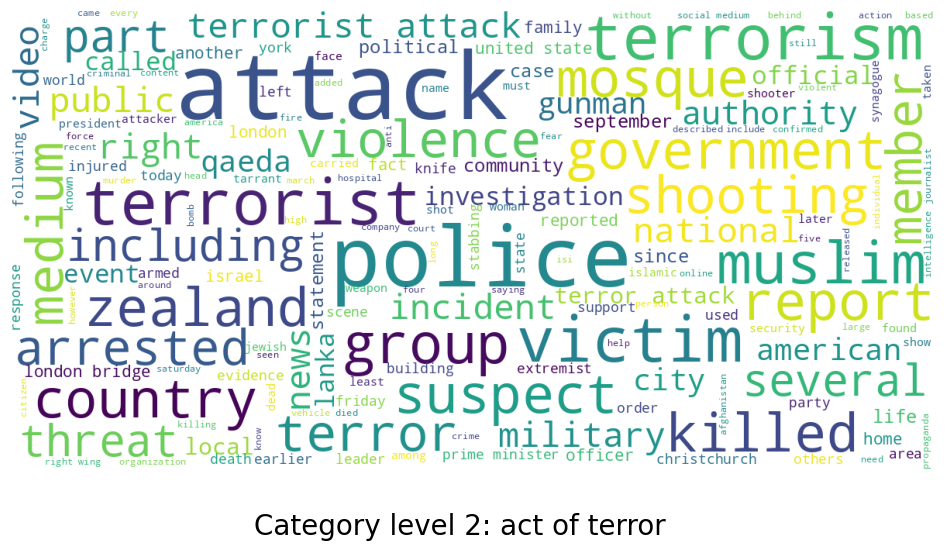

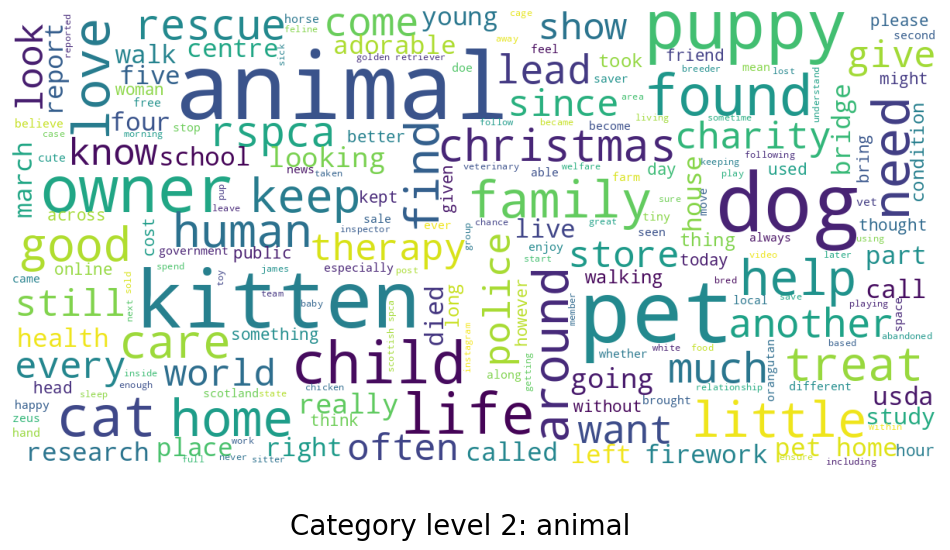

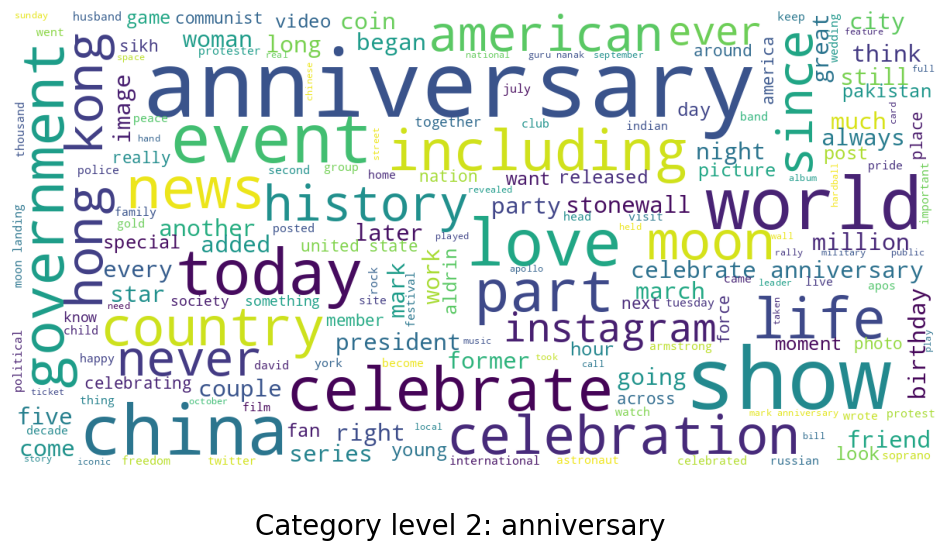

...

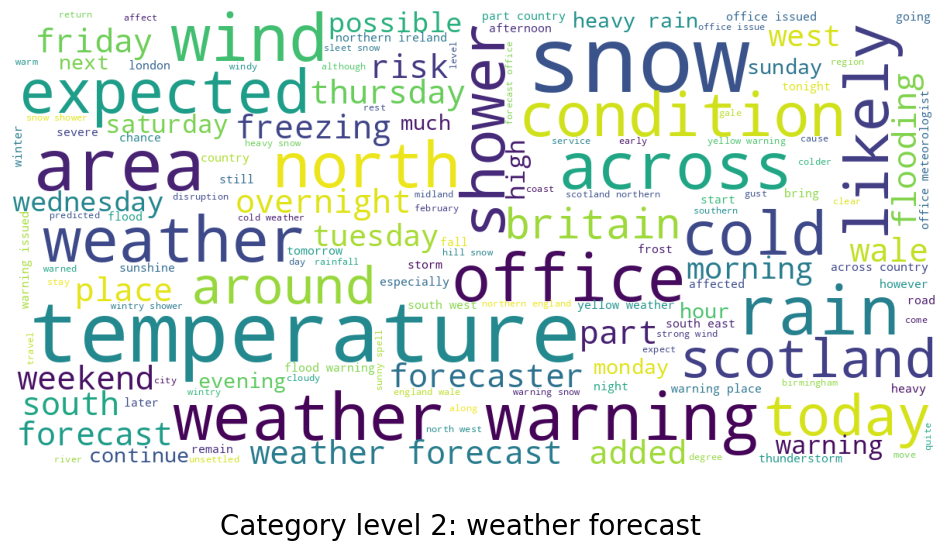

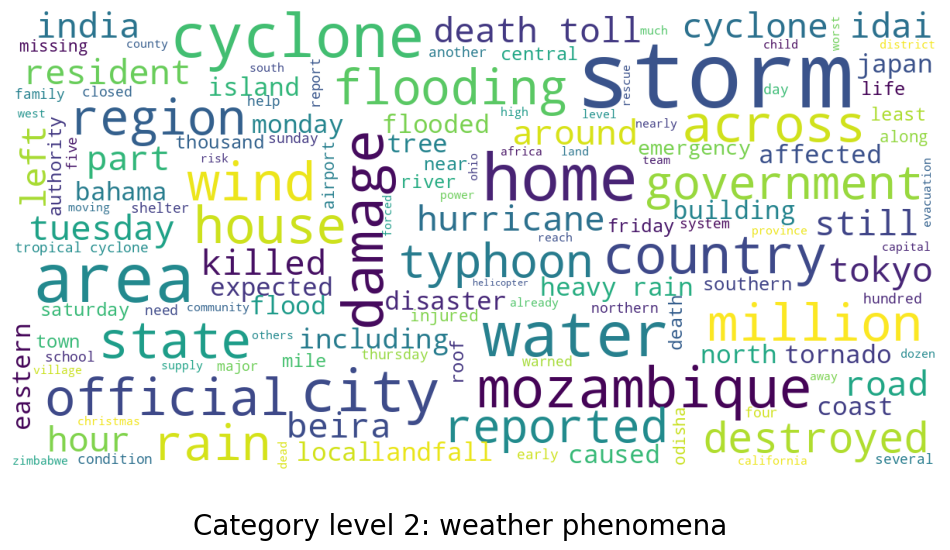

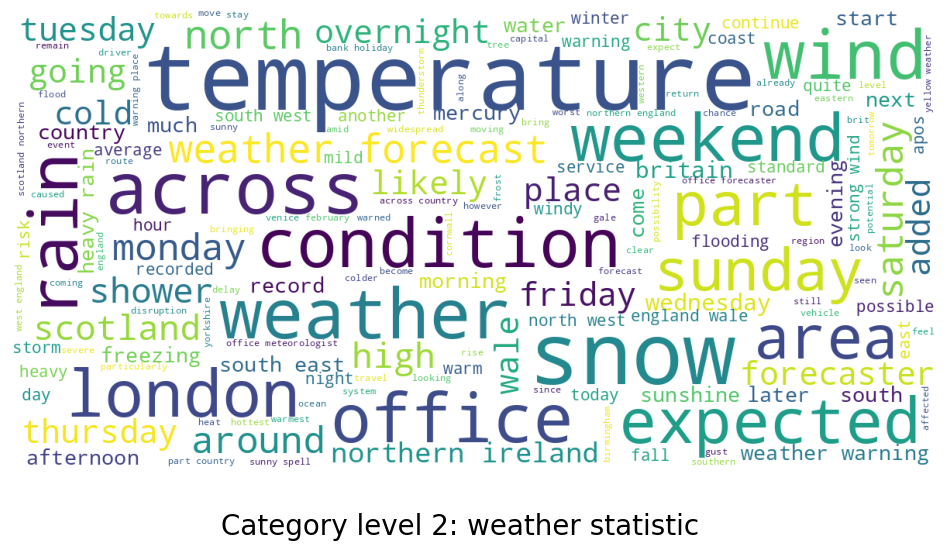

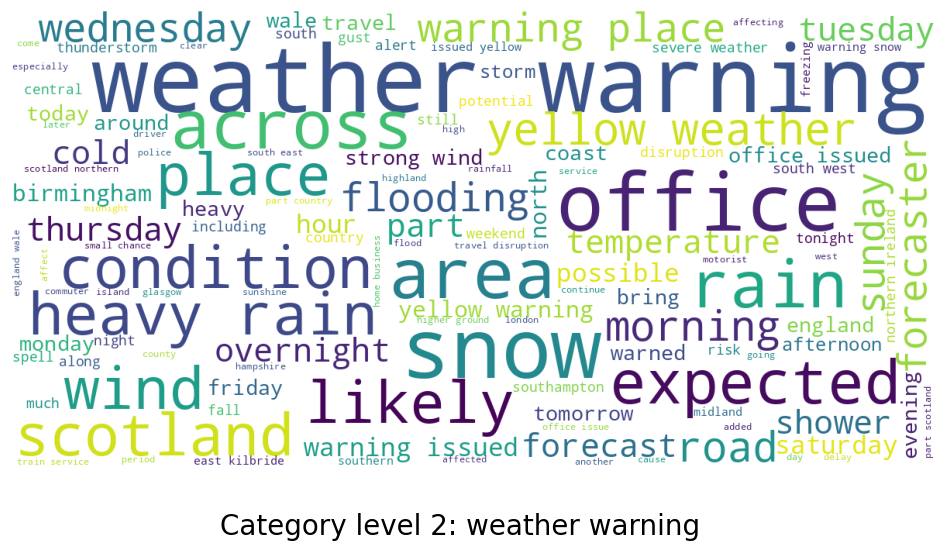

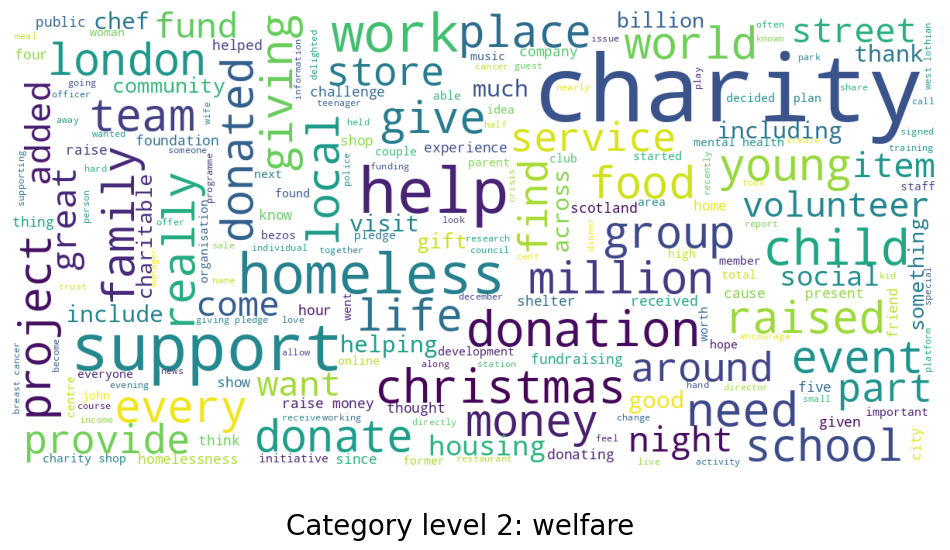

""


In [16]:
df.groupby('category_level_2').apply(
    lambda x: show_wordcloud(x.text.tolist(), title=f"Category level 2: {x.name}")
)

Mean number of non-repeated words in article body for first-level categories.

In [17]:
# Add column 'len' => number of words in the article (content+title)
def counter(x):
    return len(set(x.split(' ')))
df['len'] = df.text.apply(counter)

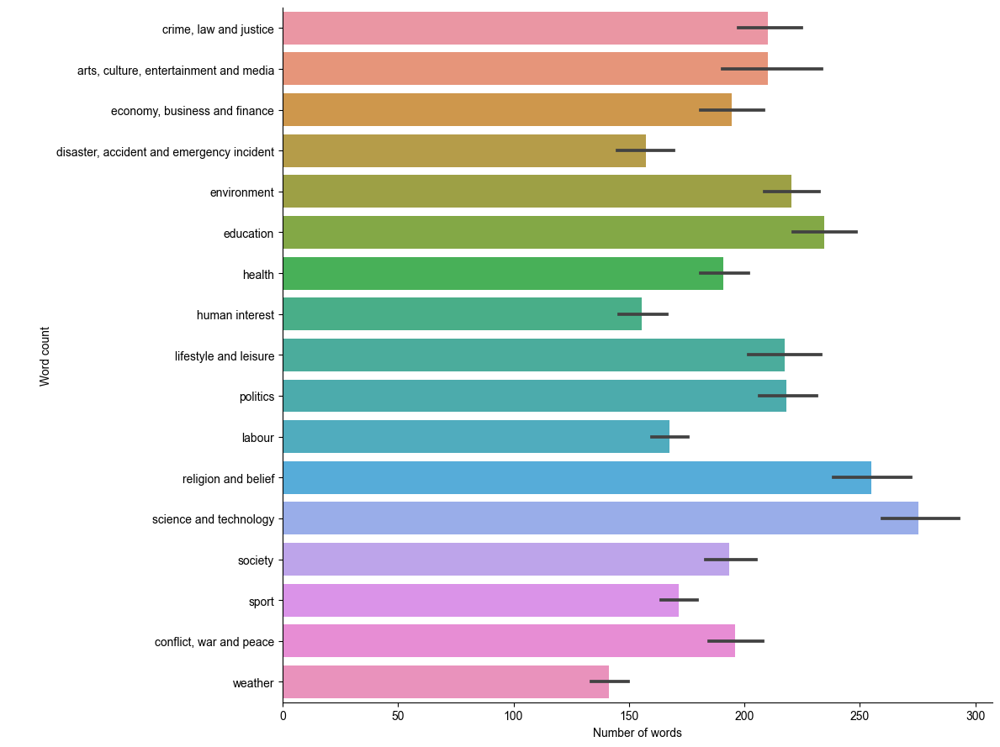

In [18]:
catpl = sns.catplot(data=df, kind="bar", x="len", y="category_level_1", height=9, aspect=12/9)
sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'white'})
catpl.set_titles('Mean number of words in article body for each category', fontsize=16);
catpl.set_xlabels('Number of words');
catpl.set_ylabels('Word count');

## Multilabel classification

In [19]:
def train_nb(X, y):
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,random_state=42)
    
    # Define a pipeline combining a text feature extractor with multi lable classifier
    NB_pipeline = Pipeline([
                    ('clf', OneVsRestClassifier(MultinomialNB())),
                ])

    NB_pipeline.fit(X_train, y_train)
    # compute the testing accuracy
    prediction = NB_pipeline.predict(X_test)
    print('Precision is {}'.format(precision_score(y_test, prediction, average='macro')))
    print('Recall is {}'.format(recall_score(y_test, prediction, average='macro')))
    print('F1:', f1_score(y_test, prediction, average='macro'))

In [20]:
def train_lr(X, y):
    y = encode_labels(y)

    X_train_lr, X_test_lr, y_train_lr, y_test_lr = train_test_split(X, y, test_size=0.2,random_state=42)

    # Using pipeline for applying logistic regression and one vs rest classifier
    model = OneVsRestClassifier(LogisticRegression(solver='sag'))

    # Fitting the model with training data
    model.fit(X_train_lr, y_train_lr)

    # Making a prediction on the test set
    prediction = model.predict(X_test_lr)

    # Evaluating the model
    print('Precision is {}'.format(precision_score(y_test_lr, prediction, average='macro')))
    print('Recall is {}'.format(recall_score(y_test_lr, prediction, average='macro')))
    print('F1:', f1_score(y_test_lr, prediction, average='macro'))

In [21]:
def train_svc(X, y):
    
    y = encode_labels(y)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,random_state=42)
    
    # Creating the SVM model
    model = OneVsRestClassifier(SVC())

    # Fitting the model with training data
    model.fit(X_train, y_train)

    # Making a prediction on the test set
    prediction = model.predict(X_test)

    # Evaluating the model
    print('Precision is {}'.format(precision_score(y_test, prediction, average='macro')))
    print('Recall is {}'.format(recall_score(y_test, prediction, average='macro')))
    print('F1:', f1_score(y_test, prediction, average='macro'))

### TFIDF

In [22]:
def get_tfidf(X):
    # Use TfidfVectorizer. Output: Vectors for train text.
    vectorizer = TfidfVectorizer(strip_accents='unicode', analyzer='word', ngram_range=(1,2), norm='l2', max_features=50000)
    vectors = vectorizer.fit_transform(X)

    return vectors.toarray()
    

In [23]:
def encode_labels(y):
    le = LabelEncoder()
    return le.fit_transform(y)

In [24]:
X_tfidf = get_tfidf(df['text'])

#### Naive Bayes

Level 1 categories

In [25]:
train_nb(X_tfidf, df['category_level_1'])

Precision is 0.8019714674627598
Recall is 0.6310102334213202
F1: 0.6494601982251749


Level 2 categories

In [26]:
train_nb(X_tfidf, df['category_level_2'])

Precision is 0.627543637377195
Recall is 0.6021573117455853
F1: 0.5829040525638204


#### Logistic Regression

Level 1 categories

In [27]:
train_lr(X_tfidf, df['category_level_1'])

Precision is 0.7998824936863782
Recall is 0.7626760063463046
F1: 0.7741875051862541


Level 2 categories

In [28]:
train_lr(X_tfidf, df['category_level_2'])

Precision is 0.6458761865738226
Recall is 0.6491026680021457
F1: 0.6349700593164243


#### SVC

Level 1 categories

In [29]:
train_svc(X_tfidf, df['category_level_1'])

Precision is 0.8080756936983825
Recall is 0.7958091141941015
F1: 0.7987683033153442


Level 2 categories

In [31]:
train_svc(X_tfidf, df['category_level_2'])

Precision is 0.644683878677045
Recall is 0.6457388894303706
F1: 0.6279842548847295


### glove

In [32]:
!wget http://nlp.stanford.edu/data/glove.840B.300d.zip

--2022-12-21 03:20:18--  http://nlp.stanford.edu/data/glove.840B.300d.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://nlp.stanford.edu/data/glove.840B.300d.zip [following]
--2022-12-21 03:20:18--  https://nlp.stanford.edu/data/glove.840B.300d.zip
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip [following]
--2022-12-21 03:20:19--  https://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2176768927 (2,0G) [application/

In [33]:
# !unzip glove*.zip

Archive:  glove.840B.300d.zip
replace glove.840B.300d.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: ^C


In [34]:
def loadGloveModel(gloveFile):
    print("Loading Glove Model")
    f = open(gloveFile,'r', encoding='utf8')
    model = {}
    for line in f:
        splitLine = line.split(' ')
        word = splitLine[0]
        embedding = np.asarray(splitLine[1:], dtype='float32')
        model[word] = embedding
    print("Done.",len(model)," words loaded!")
    return model

In [35]:
embedding = loadGloveModel('glove.840B.300d.txt')

Loading Glove Model
Done. 2196016  words loaded!


In [36]:
def mean_vector(data):
    vec_list = []
    for sting in data:
        l = 0
        vector = np.zeros(300)
        for word in sting:
            try:
                vector += embedding[word]
                l += 1
            except Exception as e:
                pass
        vector = vector / l
        vec_list.append(vector)
    return vec_list

In [37]:
def preprocces(X):
    X_proccessed = []
    for x in X:
        x = word_tokenize(x)
        X_proccessed.append(x)
    return X_proccessed

In [40]:
%%time
X_preprocessed = preprocces(df['text'])
vectors = mean_vector(X_preprocessed)
X_tokens = np.array(vectors)

CPU times: user 14 s, sys: 521 ms, total: 14.6 s
Wall time: 14.8 s


In [41]:
scaler = MinMaxScaler()
X_glove = scaler.fit_transform(X_tokens)

#### Naive Bayes

Level 1 categories

In [42]:
train_nb(X_glove, df['category_level_1'])

Precision is 0.6286285684931707
Recall is 0.49947614258021744
F1: 0.5286410194470099


/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Level 2 categories

In [43]:
train_nb(X_glove, df['category_level_2'])

Precision is 0.49572163799138735
Recall is 0.4835036528012727
F1: 0.46851943258707524


#### Multinomial logistic regression

Level 1 categories

In [44]:
train_lr(X_glove, df['category_level_1'])

/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackp

Precision is 0.7470253799059228
Recall is 0.7390927413985686
F1: 0.7392536520685498


/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Level 2 categories

In [45]:
train_lr(X_glove, df['category_level_2'])

/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackp

/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackp

/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackproject/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/opt/anaconda3/envs/hackp

Precision is 0.5891508262338482
Recall is 0.5892191186421522
F1: 0.5769754906918195


#### SVC

Level 1 categories

In [46]:
train_svc(X_glove, df['category_level_1'])

Precision is 0.7682253376176366
Recall is 0.7622913783517663
F1: 0.7600920790098902


Level 2 categories

In [47]:
train_svc(X_glove, df['category_level_2'])

Precision is 0.580779389366155
Recall is 0.5951974698987583
F1: 0.570872006249404


# DistilBert

In [49]:
import tensorflow as tf
from transformers import DistilBertTokenizer, TFDistilBertModel

In [50]:
tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased-finetuned-sst-2-english')
layer = TFDistilBertModel.from_pretrained("distilbert-base-uncased-finetuned-sst-2-english")

2022-12-21 09:23:20.910452: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
Some layers from the model checkpoint at distilbert-base-uncased-finetuned-sst-2-english were not used when initializing TFDistilBertModel: ['pre_classifier', 'dropout_19', 'classifier']
- This IS expected if you are initializing TFDistilBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFDistilBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClass

In [51]:
def regular_encode(texts, tokenizer,  maxlen=512):
    enc_di = tokenizer.batch_encode_plus(
        texts, 
        truncation=True,
        return_attention_mask=False, 
        return_token_type_ids=False,
        padding=True,
        max_length=maxlen
    )
    
    return np.array(enc_di['input_ids'])

In [52]:
def build_model(transformer, y_shape, loss='categorical_crossentropy', max_len=512):
    input_word_ids = tf.keras.layers.Input(shape=(max_len,), dtype=tf.int32, name="input_word_ids")
    sequence_output = transformer(input_word_ids)[0]
    cls_token = sequence_output[:, 0, :]
    #adding dropout layer
    
    x = tf.keras.layers.Dropout(0.3)(cls_token)

    #using a dense layer of category size neurons. 
    out = tf.keras.layers.Dense(y_shape, activation='softmax')(x)
    model = tf.keras.Model(inputs=input_word_ids, outputs=out)

    #using categorical crossentropy as the loss as it is a multi-class classification problem
    model.compile(tf.keras.optimizers.Adam(learning_rate=5e-5), loss=loss, metrics=['accuracy'])
    return model

In [53]:
def train_dist_bert(X, y):
    
    y_lr = encode_labels(y)

    #converting the categories into one hot vectors using tf.keras.utils.to_categorical
    y_cat = tf.keras.utils.to_categorical(y_lr, dtype = 'int32')

    X_train, X_test, y_train, y_test = train_test_split(X, y_cat, random_state = 42, test_size = 0.2)
    
    #building the model
    model = build_model(layer, max_len=80, y_shape=y_cat.shape[1])
    
    #creating the training and testing dataset.
    BATCH_SIZE = 32
    AUTO = tf.data.experimental.AUTOTUNE 
    train_dataset = (
        tf.data.Dataset
        .from_tensor_slices((X_train, y_train))
        .repeat()
        .shuffle(2048)
        .batch(BATCH_SIZE)
        .prefetch(AUTO)
    )
    test_dataset = (
        tf.data.Dataset
        .from_tensor_slices(X_test)
        .batch(BATCH_SIZE)
    )
    
    #training for 10 epochs
    n_steps = X_train.shape[0] // BATCH_SIZE
    train_history = model.fit(
        train_dataset,
        steps_per_epoch=n_steps,
        epochs=10
    )
    
    #making predictions
    preds = model.predict(test_dataset,verbose = 1)
    #converting the one hot vector output to a linear numpy array.
    pred_classes = np.argmax(preds, axis = 1)
    
    print('Precision is {}'.format(precision_score(np.argmax(y_test, axis=1), pred_classes, average='macro')))
    print('Recall is {}'.format(recall_score(np.argmax(y_test, axis=1), pred_classes, average='macro')))
    print('F1:', f1_score(np.argmax(y_test, axis=1), pred_classes, average='macro'))

In [54]:
X_encoded = regular_encode(df['text'].astype('str'), tokenizer, maxlen=80)

Level 1 categories

In [55]:
train_dist_bert(X_encoded, df['category_level_1'])

Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089
Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
272/272 [==============================] - 848s 3s/step - loss: 1.1229 - accuracy: 0.6698
Epoch 2/10
2

Level 2 categories

In [56]:
train_dist_bert(X_encoded, df['category_level_2'])

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: closure mismatch, requested ('self', 'step_function'), but source function had ()
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
272/272 [==============================] - 12991s 48s/step - loss: 1.6326 - accuracy: 0.5823
Epoch 2/10
272/272 [==============================] - 834s 3s/step - loss: 0.6029 - accuracy: 0.8130
Epoch 3/10
272/272 [==============================] - 816s 3s/step - loss: 0.4059 - accuracy: 0.8722
Epoch 4/